# Initial Imports and Constants

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import lightkurve as lk
from lightkurve import search_targetpixelfile
import pandas as pd
import os
import batman
from scipy.stats import norm
import matplotlib
import os

In [2]:
### Define data directory
working_dir = os.getcwd()
data_dir = os.path.join(working_dir, "data")
print(f"Data directory: {data_dir}")

Data directory: /Users/pentrican10/Projects/tess-resonant-systems/data


In [3]:
### switch to mask out transits
mask_transits = True
### set range for search: [#hours] * [days per hour]
ttv_hour = 2* 0.0416667 # 1 hour to days

In [4]:
### function to convert times from TESS to Petigura offset
TESS_offset = 2457000
petigura_offset = 2454833
def convert_time_t2p(times):
    ### TESS offset 
    BTJD = times + TESS_offset
    new_time = BTJD - petigura_offset
    return new_time

# Get data

In [5]:
TOI_id = 'TOI 175'
search_result = lk.search_lightcurve(TOI_id, author='SPOC')
print(search_result)
# lc_collection = search_result.download_all()
# lc = lc_collection
# lc[0].download()
# lc[1].download()
# lc[2].download()
# lc[3].download()


# lc_collection = lc[0].download()
# lc_collection.append(lc[1].download())
# lc_collection.append(lc[3].download())

SearchResult containing 43 data products.

 #     mission     year author exptime target_name distance
                                  s                 arcsec 
--- -------------- ---- ------ ------- ----------- --------
  0 TESS Sector 02 2018   SPOC     120   307210830      0.0
  1 TESS Sector 05 2018   SPOC     120   307210830      0.0
  2 TESS Sector 08 2019   SPOC     120   307210830      0.0
  3 TESS Sector 09 2019   SPOC     120   307210830      0.0
  4 TESS Sector 10 2019   SPOC     120   307210830      0.0
  5 TESS Sector 11 2019   SPOC     120   307210830      0.0
  6 TESS Sector 12 2019   SPOC     120   307210830      0.0
  7 TESS Sector 28 2020   SPOC      20   307210830      0.0
  8 TESS Sector 29 2020   SPOC      20   307210830      0.0
...            ...  ...    ...     ...         ...      ...
 33 TESS Sector 69 2023   SPOC     120   307210830      0.0
 34 TESS Sector 62 2023   SPOC     120   307210830      0.0
 35 TESS Sector 87 2024   SPOC      20   307210830      0

In [6]:
lc_collection = search_result.download_all()
# lc_collection.plot()
# plt.show()
print(lc_collection)

LightCurveCollection of 43 objects:
    0: <TessLightCurve LABEL="TIC 307210830" SECTOR=2 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
    1: <TessLightCurve LABEL="TIC 307210830" SECTOR=5 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
    2: <TessLightCurve LABEL="TIC 307210830" SECTOR=8 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
    3: <TessLightCurve LABEL="TIC 307210830" SECTOR=9 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
    4: <TessLightCurve LABEL="TIC 307210830" SECTOR=10 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
    5: <TessLightCurve LABEL="TIC 307210830" SECTOR=11 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
    6: <TessLightCurve LABEL="TIC 307210830" SECTOR=12 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
    7: <TessLightCurve LABEL="TIC 307210830" SECTOR=28 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
    8: <TessLightCurve LABEL="TIC 307210830" SECTOR=29 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
    9: <TessLightCurve LABEL="TIC 307210830" SECTOR=32 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
    10: <TessLightCurve LABEL="TIC 307210830" SE

In [7]:
clean_lcs = [lc[lc.quality == 0] for lc in lc_collection]


In [8]:
# Normalize, flatten, and remove outliers
processed_lcs = [
    lc.normalize().flatten(window_length=401).remove_outliers(sigma=5)
    for lc in clean_lcs
]

In [9]:
# Stitch into one combined light curve
combined_lc = processed_lcs[0]
for lc in processed_lcs[1:]:
    combined_lc = combined_lc.append(lc)



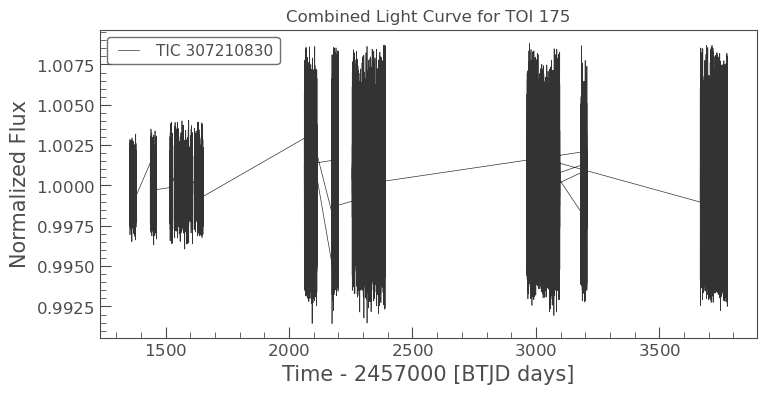

In [10]:
combined_lc.plot()
plt.title(f"Combined Light Curve for {TOI_id}")
plt.show()

In [11]:
# Extract useful data arrays
time = combined_lc.time.value
flux = combined_lc.flux.value
flux_err = combined_lc.flux_err.value
print(time)
print(flux)

[1354.10741134 1354.1088002  1354.11018906 ... 3775.07466024 3775.07604913
 3775.07743802]
[1.00058204 1.00141817 1.00059003 ... 1.00058993 1.00065411 0.99985535]


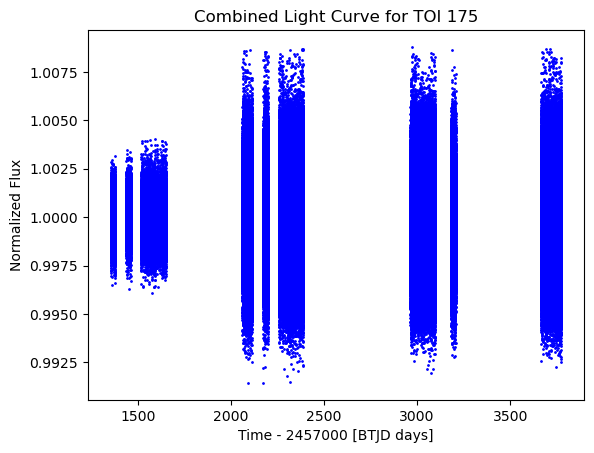

In [12]:
plt.scatter(time, flux, s=1, c='b')
plt.title(f'Combined Light Curve for {TOI_id}')
plt.xlabel('Time - 2457000 [BTJD days]')
plt.ylabel('Normalized Flux')
plt.show()

# BLS Runs

## BLS 1

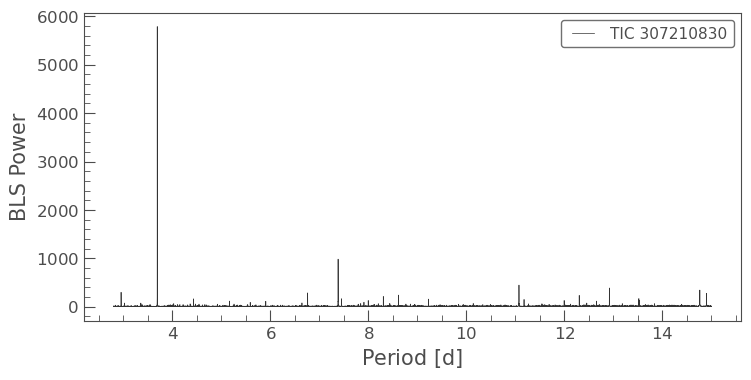

In [36]:
bls_1 = combined_lc.to_periodogram(method='bls', period=np.linspace(2.8, 15, 10000), frequency_factor=500)
bls_1.plot()
plt.show()


In [37]:
planet_1_period = bls_1.period_at_max_power
planet_1_dur = bls_1.duration_at_max_power
planet_1_t0 = bls_1.transit_time_at_max_power

print(f"Best candidate period: {planet_1_period.value:.5f} days")
print(f"Best candidate t0: {planet_1_t0.value:.5f} days")

Best candidate period: 3.69069 days
Best candidate t0: 1356.19741 days


In [38]:
import numpy as np
from scipy.signal import find_peaks

# 1. Access full power array
powers = bls_1.power.value
periods = bls_1.period.value
durations = bls_1.duration.value
t0s = bls_1.transit_time.value

# 2. Find all peaks in the BLS power spectrum
peaks, _ = find_peaks(powers)

# 3. Sort peaks by power (descending)
sorted_peaks = peaks[np.argsort(powers[peaks])[::-1]]

# 4. Get top 3 signal indices
top_indices = sorted_peaks[:7]

# 5. Extract their periods, durations, and t0s
top_periods = periods[top_indices]
top_durations = durations[top_indices]
top_t0s = t0s[top_indices]
top_powers = powers[top_indices]

# 6. Print results
for i in range(7):
    print(f"Signal {i+1}:")
    print(f"  Period:   {top_periods[i]:.5f} days")
    print(f"  T0:       {top_t0s[i]:.5f}")
    print(f"  Duration: {top_durations[i]:.5f} days")
    print(f"  Power:    {top_powers[i]:.5f}")
    print("-" * 30)


Signal 1:
  Period:   3.69069 days
  T0:       1356.19741
  Duration: 0.05000 days
  Power:    5788.11044
------------------------------
Signal 2:
  Period:   7.38156 days
  T0:       1356.17241
  Duration: 0.05000 days
  Power:    982.53402
------------------------------
Signal 3:
  Period:   11.07243 days
  T0:       1356.15741
  Duration: 0.10000 days
  Power:    446.81741
------------------------------
Signal 4:
  Period:   12.91725 days
  T0:       1356.21241
  Duration: 0.05000 days
  Power:    386.92307
------------------------------
Signal 5:
  Period:   14.76330 days
  T0:       1356.16241
  Duration: 0.10000 days
  Power:    344.06987
------------------------------
Signal 6:
  Period:   2.95252 days
  T0:       1356.21241
  Duration: 0.05000 days
  Power:    298.29585
------------------------------
Signal 7:
  Period:   6.75930 days
  T0:       1357.16741
  Duration: 0.05000 days
  Power:    284.95261
------------------------------


In [39]:
# Create a cadence mask using the BLS parameters
planet_1_mask = bls_1.get_transit_mask(period=planet_1_period,
                                     transit_time=planet_1_t0,
                                     duration=planet_1_dur*1.5)

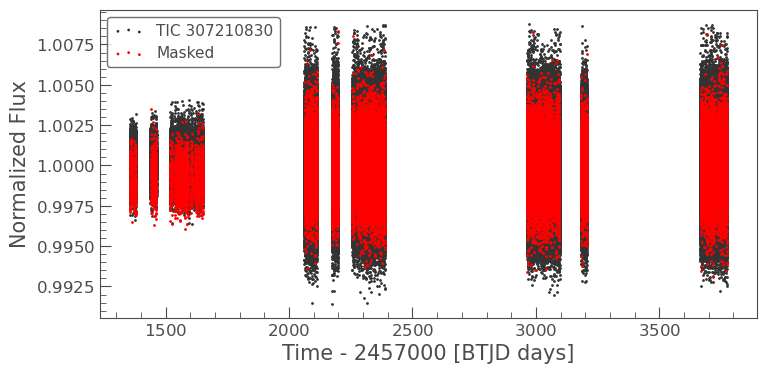

In [40]:
masked_lc_1 = combined_lc[~planet_1_mask]
ax = masked_lc_1.scatter();
combined_lc[planet_1_mask].scatter(ax=ax, c='r', label='Masked')
# plt.xlim(2144, 2145)
plt.show()

In [41]:
# Create a BLS model using the BLS parameters
planet_1_model = bls_1.get_transit_model(period=planet_1_period,
                                       transit_time=planet_1_t0,
                                       duration=planet_1_dur)


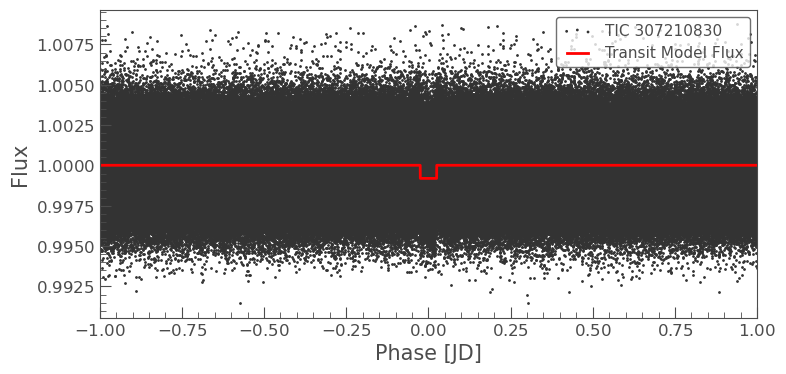

In [42]:
ax = combined_lc.fold(planet_1_period, planet_1_t0).scatter()
planet_1_model.fold(planet_1_period, planet_1_t0).plot(ax=ax, c='r', lw=2)
ax.set_xlim(-1, 1)
plt.show()

## BLS 2

`period` contains 218814 points.Periodogram is likely to be large, and slow to evaluate. Consider setting `frequency_factor` to a higher value.


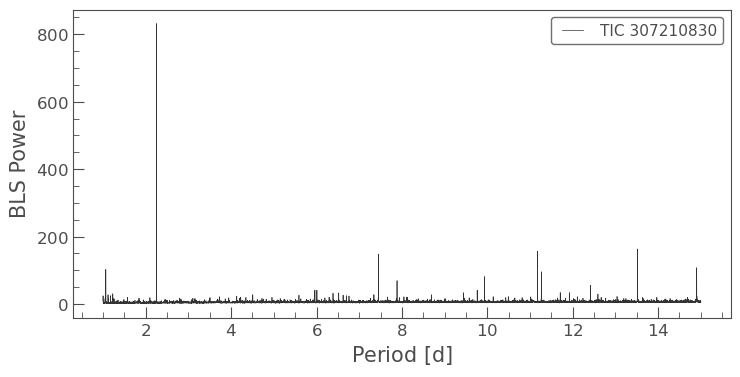

In [58]:
period = np.linspace(1, 15, 10000)
bls_2 = masked_lc_1.to_periodogram('bls', period=period, frequency_factor=500)
bls_2.plot()
plt.show()

In [59]:
planet_2_period = bls_2.period_at_max_power
planet_2_t0 = bls_2.transit_time_at_max_power
planet_2_dur = bls_2.duration_at_max_power

print(f"Best candidate period 2: {planet_2_period.value:.5f} days")
print(f"Best candidate t0 2: {planet_2_t0.value:.5f} days")

Best candidate period 2: 2.25313 days
Best candidate t0 2: 1354.89741 days


In [60]:
# ax = masked_lc_1.fold(planet_2_period, planet_2_t0).scatter()
# masked_lc_1.fold(planet_2_period, planet_2_t0).bin(.1).plot(ax=ax, c='r', lw=2,
#                                                           label='Binned Flux')
# ax.set_xlim(-5, 5)
# plt.show()

In [61]:
planet_2_mask = bls_2.get_transit_mask(period=planet_2_period,
                                     transit_time=planet_2_t0,
                                     duration=planet_2_dur*1.5)

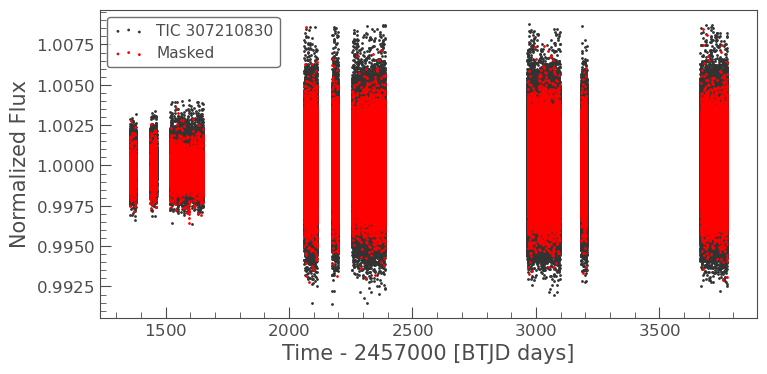

In [62]:
masked_lc_2 = masked_lc_1[~planet_2_mask]
ax = masked_lc_2.scatter();
masked_lc_1[planet_2_mask].scatter(ax=ax, c='r', label='Masked')
# plt.xlim(2144, 2145)
plt.show()

In [63]:
planet_2_model = bls_2.get_transit_model(period=planet_2_period,
                                       transit_time=planet_2_t0,
                                       duration=planet_2_dur)

## BLS 3

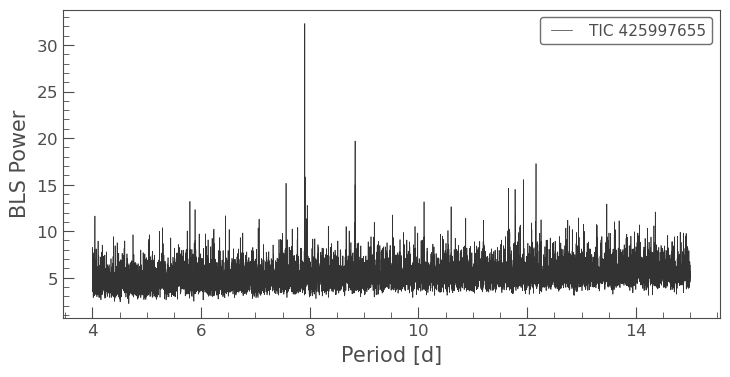

In [27]:
### start period search at 4days to try to find planet e before d
period = np.linspace(4, 15, 10000)
bls_3 = masked_lc_2.to_periodogram('bls', period=period, frequency_factor=500)
bls_3.plot()
plt.show()

In [28]:
planet_3_period = bls_3.period_at_max_power
planet_3_t0 = bls_3.transit_time_at_max_power
planet_3_dur = bls_3.duration_at_max_power

print(f"Best candidate period 3: {planet_3_period.value:.5f} days")
print(f"Best candidate t0 3: {planet_3_t0.value:.5f} days")

Best candidate period 3: 7.90759 days
Best candidate t0 3: 1330.83631 days


In [29]:
planet_3_mask = bls_3.get_transit_mask(period=planet_3_period,
                                     transit_time=planet_3_t0,
                                     duration=planet_3_dur*1.5)


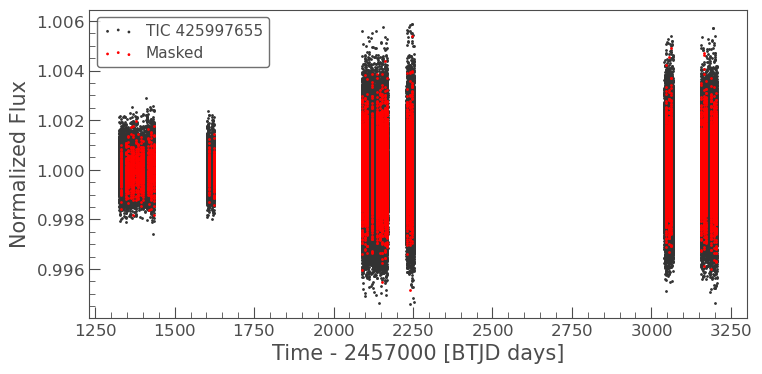

In [30]:
masked_lc_3 = masked_lc_2[~planet_3_mask]
ax = masked_lc_3.scatter();
masked_lc_2[planet_3_mask].scatter(ax=ax, c='r', label='Masked')
# plt.xlim(2144, 2145)
plt.show()

In [31]:
planet_3_model = bls_3.get_transit_model(period=planet_3_period,
                                       transit_time=planet_3_t0,
                                       duration=planet_3_dur)

## BLS 4

`period` contains 132101 points.Periodogram is likely to be large, and slow to evaluate. Consider setting `frequency_factor` to a higher value.


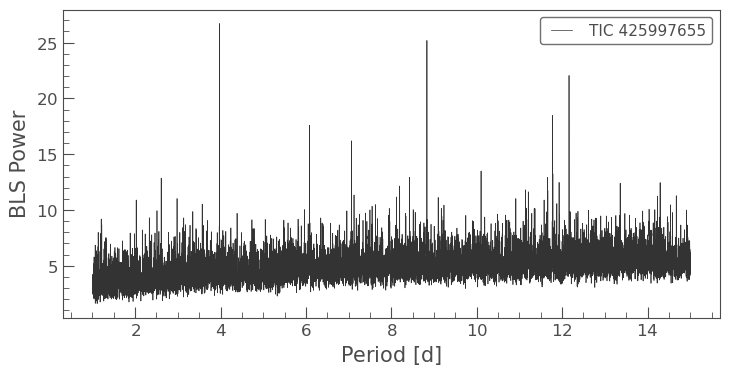

In [32]:
period = np.linspace(1, 15, 10000)
bls_4 = masked_lc_3.to_periodogram('bls', period=period, frequency_factor=500)
bls_4.plot()
plt.show()

In [33]:
planet_4_period = bls_4.period_at_max_power
planet_4_t0 = bls_4.transit_time_at_max_power
planet_4_dur = bls_4.duration_at_max_power

print(f"Best candidate period 4: {planet_4_period.value:.5f} days")
print(f"Best candidate t0 4: {planet_4_t0.value:.5f} days")

Best candidate period 4: 3.97670 days
Best candidate t0 4: 1326.01131 days


In [34]:
planet_4_mask = bls_4.get_transit_mask(period=planet_4_period,
                                     transit_time=planet_4_t0,
                                     duration=planet_4_dur*1.5)


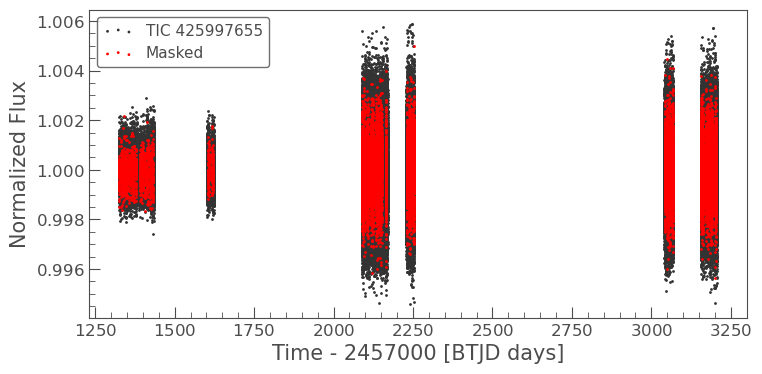

In [35]:
masked_lc_4 = masked_lc_3[~planet_4_mask]
ax = masked_lc_4.scatter();
masked_lc_3[planet_4_mask].scatter(ax=ax, c='r', label='Masked')
# plt.xlim(2144, 2145)
plt.show()

In [36]:
planet_4_model = bls_4.get_transit_model(period=planet_4_period,
                                       transit_time=planet_4_t0,
                                       duration=planet_4_dur)

## BLS 5

`period` contains 132101 points.Periodogram is likely to be large, and slow to evaluate. Consider setting `frequency_factor` to a higher value.


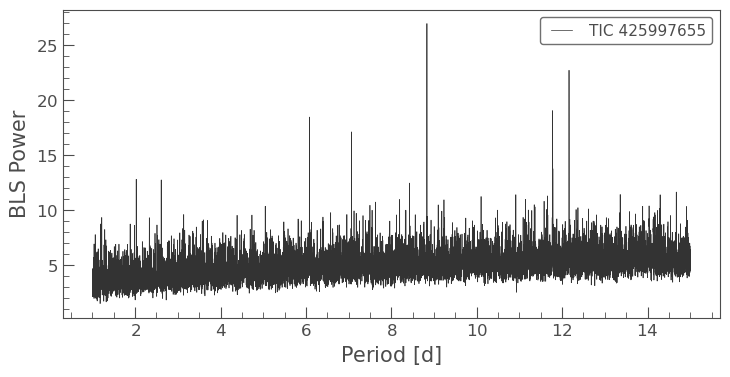

In [37]:
period = np.linspace(1, 15, 10000)
bls_5 = masked_lc_4.to_periodogram('bls', period=period, frequency_factor=500)
bls_5.plot()
plt.show()

In [38]:
planet_5_period = bls_5.period_at_max_power
planet_5_t0 = bls_5.transit_time_at_max_power
planet_5_dur = bls_5.duration_at_max_power

print(f"Best candidate period 5: {planet_5_period.value:.5f} days")
print(f"Best candidate t0 5: {planet_5_t0.value:.5f} days")

Best candidate period 5: 8.83378 days
Best candidate t0 5: 1334.14631 days


In [39]:
planet_5_mask = bls_5.get_transit_mask(period=planet_5_period,
                                     transit_time=planet_5_t0,
                                     duration=planet_5_dur*1.5)


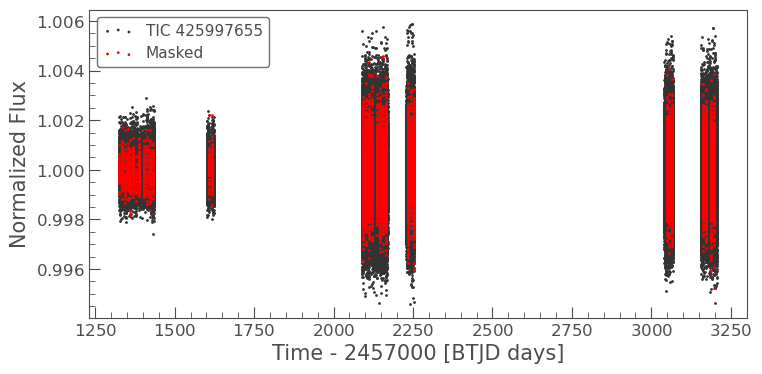

In [40]:
masked_lc_5 = masked_lc_4[~planet_5_mask]
ax = masked_lc_5.scatter();
masked_lc_4[planet_5_mask].scatter(ax=ax, c='r', label='Masked')
# plt.xlim(2144, 2145)
plt.show()

In [41]:
planet_5_model = bls_5.get_transit_model(period=planet_5_period,
                                       transit_time=planet_5_t0,
                                       duration=planet_5_dur)

## BLS 6

`period` contains 132093 points.Periodogram is likely to be large, and slow to evaluate. Consider setting `frequency_factor` to a higher value.


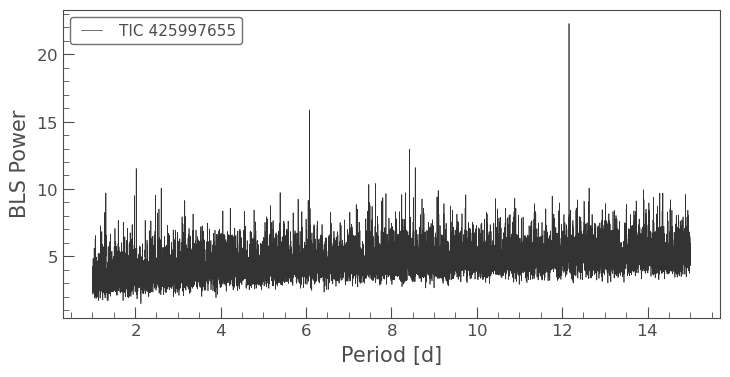

In [42]:
period = np.linspace(1, 15, 10000)
bls_6 = masked_lc_5.to_periodogram('bls', period=period, frequency_factor=500)
bls_6.plot()
plt.show()

In [43]:
planet_6_period = bls_6.period_at_max_power
planet_6_t0 = bls_6.transit_time_at_max_power
planet_6_dur = bls_6.duration_at_max_power

print(f"Best candidate period 6: {planet_6_period.value:.5f} days")
print(f"Best candidate t0 6: {planet_6_t0.value:.5f} days")

Best candidate period 6: 12.16192 days
Best candidate t0 6: 1335.78325 days


In [44]:
planet_6_mask = bls_6.get_transit_mask(period=planet_6_period,
                                     transit_time=planet_6_t0,
                                     duration=planet_6_dur*1.5)


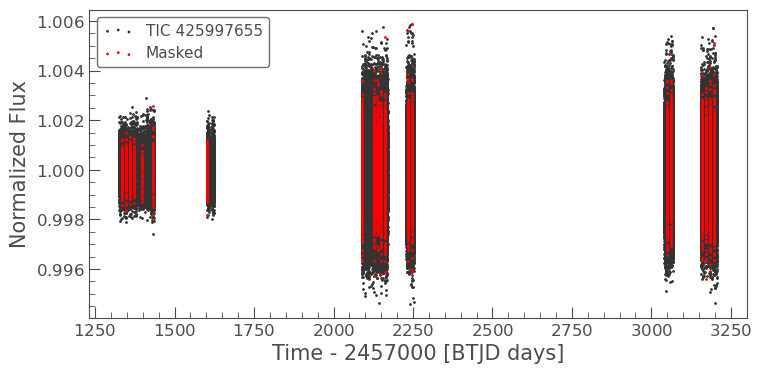

In [45]:
masked_lc_6 = masked_lc_5[~planet_6_mask]
ax = masked_lc_6.scatter();
masked_lc_5[planet_6_mask].scatter(ax=ax, c='r', label='Masked')
# plt.xlim(2144, 2145)
plt.show()

In [46]:
planet_6_model = bls_6.get_transit_model(period=planet_6_period,
                                       transit_time=planet_6_t0,
                                       duration=planet_6_dur)

## Transit models

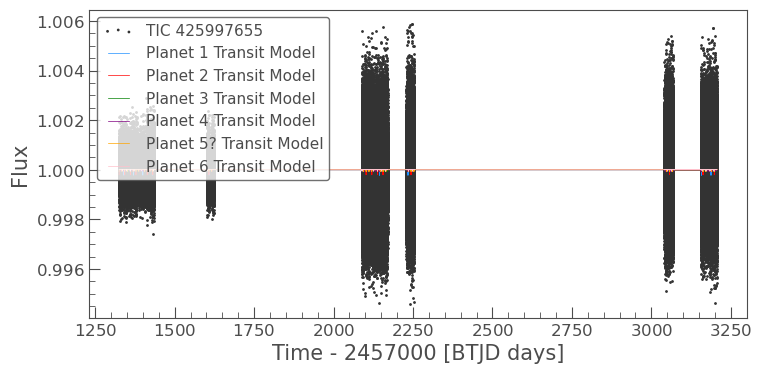

In [47]:
ax = combined_lc.scatter();
planet_1_model.plot(ax=ax, c='dodgerblue', label='Planet 1 Transit Model');
planet_2_model.plot(ax=ax, c='r', label='Planet 2 Transit Model');
# planet_3_model.plot(ax=ax, c='g', label='Planet 3 Transit Model');
# planet_4_model.plot(ax=ax, c='purple', label='Planet 4 Transit Model');
# planet_5_model.plot(ax=ax, c='orange', label='Planet 5? Transit Model');
# planet_6_model.plot(ax=ax, c='pink', label='Planet 6 Transit Model');

# plt.xlim(1340,1345)
# plt.ylim(0.998,1.002)
plt.show()

## Finding transit guess times based on models 

In [43]:
from scipy.signal import find_peaks

# Find all local minima (i.e., transit dips)
peaks_1, _ = find_peaks(-planet_1_model.flux.value, prominence=1e-5)
transit_times_1 = planet_1_model.time.value[peaks_1]
fluxes_1 = planet_1_model.flux.value[peaks_1]

print("Planet 1 transit dip times and depths:")
# for t, f in zip(transit_times_1, fluxes_1):
#     print(f"Time: {t:.5f}, Flux: {f:.6f}")
print(transit_times_1)

Planet 1 transit dip times and depths:
[1356.19487546 1359.88787392 1363.57809491 1370.96131035 1374.65015748
 1378.34039431 1441.0820818  1444.77380146 1448.46413233 1452.15584455
 1455.84479849 1459.53653324 1463.226876   1518.58639679 1522.27814602
 1525.96850112 1537.04092839 1540.73126835 1544.42159656 1548.11193461
 1551.80365462 1555.49397225 1559.18429068 1562.875999   1566.56630906
 1573.94690403 1577.63859089 1581.32887716 1585.01915505 1588.70943891
 1592.4011035  1603.47188922 1607.16353221 1618.23564777 1621.9258823
 1629.30911502 1632.99795163 1636.68955819 1644.06997855 1647.76157928
 1651.45178427 2064.80947802 2068.5008362  2072.19126667 2075.88123485
 2079.57237003 2083.26373599 2090.64439047 2094.33553691 2098.02552635
 2105.40713816 2109.09760563 2112.78876848 2175.53008992 2179.22134787
 2182.9114496  2190.29282162 2193.98386266 2197.67420942 2064.80889933
 2068.49910013 2075.88088764 2079.57109691 2083.26269434 2090.64450621
 2094.33472674 2098.02494766 2105.40679

In [64]:
# Find all local minima (i.e., transit dips)
peaks_2, _ = find_peaks(-planet_2_model.flux.value, prominence=1e-5)
transit_times_2 = planet_2_model.time.value[peaks_2]
fluxes_2 = planet_2_model.flux.value[peaks_2]

print("Planet 2 transit dip times and depths:")
# for t, f in zip(transit_times_2, fluxes_2):
#     print(f"Time: {t:.5f}, Flux: {f:.6f}")
print(transit_times_2)

Planet 2 transit dip times and depths:
[1354.89628575 1357.15041597 1359.40315909 1361.6586802  1363.91003411
 1366.16416334 1370.66686942 1372.92239891 1375.1751517  1377.42790461
 1379.6806563  1438.26260149 1440.51540732 1442.76821679 1445.0224162
 1447.27522671 1449.52803522 1451.78222764 1454.03365458 1456.28786218
 1458.54068154 1460.79350065 1463.04631758 1519.37530352 1521.62813175
 1523.88095823 1526.13378218 1528.38799093 1535.14644852 1537.3992682
 1539.64930691 1541.90628473 1546.41190745 1548.66610981 1550.91892044
 1553.17172731 1555.42452732 1557.67732755 1559.93152191 1562.18432512
 1564.43712518 1566.68992102 1571.19688416 1573.44967846 1575.70247029
 1577.95664774 1580.20943198 1586.96915906 1589.22193918 1591.47471609
 1593.72748883 1602.73994837 1604.99410289 1607.24686488 1609.49962114
 1616.25927845 1618.51203375 1620.76617481 1623.01892258 1629.77855315
 1632.03268816 1634.28404287 1636.53678312 1638.79229484 1643.29499177
 1645.5505083  1647.81435607 1650.055979

In [50]:
# Find all local minima (i.e., transit dips)
peaks_3, _ = find_peaks(-planet_3_model.flux.value, prominence=1e-6)
transit_times_3 = planet_3_model.time.value[peaks_3]
fluxes_3 = planet_3_model.flux.value[peaks_3]

print("Planet 3 transit dip times and depths:")
# for t, f in zip(transit_times_3, fluxes_3):
#     print(f"Time: {t:.5f}, Flux: {f:.6f}")
print(transit_times_3)
print(len(transit_times_3))

Planet 3 transit dip times and depths:
[1330.83558863 1346.65113076 1354.55816433 1362.46796816 1370.37357022
 1378.24443066 1386.1888696  1394.09578256 1402.00544824 1417.81914909
 1425.7259561  1433.638307   1607.60148599 1623.41707082 2121.5958245
 2137.41051507 2145.3192155  2153.2251089  2161.13353005 2169.04099945
 2089.96542112 2097.87265364 2105.78009927 2121.5940884  2137.40924194
 2145.31747941 2153.22568759 2161.1324884  2169.04065223 2089.96484241
 2097.87184345 2105.77882612 2232.30097789 2240.20982058 2248.11638065
 2232.30155658 2240.20970485 2248.11649638 3189.12027728 3197.02796253
 3204.93562005 3046.78398159 3054.69123128 3062.59876005 3157.48951889
 3165.39752207 3173.30529189 3046.78247694 3054.69088405 3062.59794986
 3157.48894018 3173.30448169 3189.11993006 3197.02692086 3204.93527283]
55


In [51]:
# Find all local minima (i.e., transit dips)
peaks_4, _ = find_peaks(-planet_4_model.flux.value, prominence=1e-6)
transit_times_4 = planet_4_model.time.value[peaks_4]
fluxes_4 = planet_4_model.flux.value[peaks_4]

print("Planet 4 transit dip times and depths:")
# for t, f in zip(transit_times_4, fluxes_4):
#     print(f"Time: {t:.5f}, Flux: {f:.6f}")

print(transit_times_4)
print(len(transit_times_4))

Planet 4 transit dip times and depths:
[1326.01048878 1329.98418282 1333.96342549 1337.94126973 1341.91772318
 1345.89417526 1349.87061823 1357.82486907 1361.80129609 1365.77771228
 1369.75412201 1373.73053123 1377.70831907 1389.63886144 1393.61523034
 1397.59159069 1401.56795187 1405.54569197 1413.49837569 1417.47609871
 1421.45103372 1425.42873889 1429.40505757 1433.38136795 1604.37921134
 1608.35566491 1616.30998285 1620.2864524  2117.374079   2121.35022385
 2125.32635697 2133.28162372 2137.25773913 2141.23407586 2145.21134644
 2149.18790991 2153.1447863  2165.09456057 2089.53787027 2093.51383157
 2097.49070739 2105.44421872 2109.42038152 2117.37326881 2121.34964515
 2125.32739863 2133.28011911 2137.25646599 2141.2341916  2145.21053626
 2149.18686826 2153.14513352 2165.09351893 2089.53706007 2093.51348435
 2097.4898972  2105.44271408 2109.42049726 2232.69911671 2236.67494892
 2240.65194037 2244.62825537 2248.60525984 2252.58180275 2232.69738064
 2236.67506465 2240.65136168 2244.6276

In [52]:
# Find all local minima (i.e., transit dips)
peaks_5, _ = find_peaks(-planet_5_model.flux.value, prominence=1e-6)
transit_times_5 = planet_5_model.time.value[peaks_5]
fluxes_5 = planet_5_model.flux.value[peaks_5]

print("Planet 5? transit dip times and depths:")
# for t, f in zip(transit_times_5, fluxes_5):
#     print(f"Time: {t:.5f}, Flux: {f:.6f}")

print(transit_times_5)
print(len(transit_times_5))

Planet 5? transit dip times and depths:
[1334.14537321 1343.01357475 1351.81508496 1360.68184192 1369.48050918
 1378.3610974  1387.14859035 1404.81653302 1413.68587332 1422.47879254
 1431.35502018 1608.03065964 1616.82665998 2120.31967284 2137.98735987
 2146.8548433  2155.65561843 2164.52119321 2093.85063955 2102.65184526
 2111.51945417 2120.31909414 2137.98840153 2146.85357017 2155.65619712
 2164.52130895 2093.85098677 2102.65103507 2111.51910695 2235.19072464
 2243.99678617 2252.85957529 2235.19176629 2243.99574452 2252.85945955
 3189.24250025 3198.06894201 3047.86709274 3056.7250626  3065.56778194
 3162.7329003  3171.5730898  3047.86720848 3056.7242524  3065.56743471
 3162.7320901  3171.57251109 3189.24354193 3198.06859478]
49


In [53]:
# Find all local minima (i.e., transit dips)
peaks_6, _ = find_peaks(-planet_6_model.flux.value, prominence=1e-6)
transit_times_6 = planet_6_model.time.value[peaks_6]
fluxes_6 = planet_6_model.flux.value[peaks_6]

print("Planet 6? transit dip times and depths:")
# for t, f in zip(transit_times_6, fluxes_6):
#     print(f"Time: {t:.5f}, Flux: {f:.6f}")

print(transit_times_6)
print(len(transit_times_6))

Planet 6? transit dip times and depths:
[1335.78290178 1347.94003767 1360.10683661 1372.26802487 1396.65409639
 1433.07720761 1603.34447242 2126.307831   2138.46976122 2150.63279355
 2162.79345126 2089.81819736 2126.30655786 2138.46895105 2150.63128895
 2162.79217814 2089.81900755 2235.76478517 2247.92749551 2235.76397501
 2247.92622239 3184.40935523 3196.55666226 3050.61433823 3062.77538283
 3160.0705877  3172.23282248 3050.61306507 3062.77434115 3160.06954602
 3172.23224376 3184.40877652 3196.55608355]
33


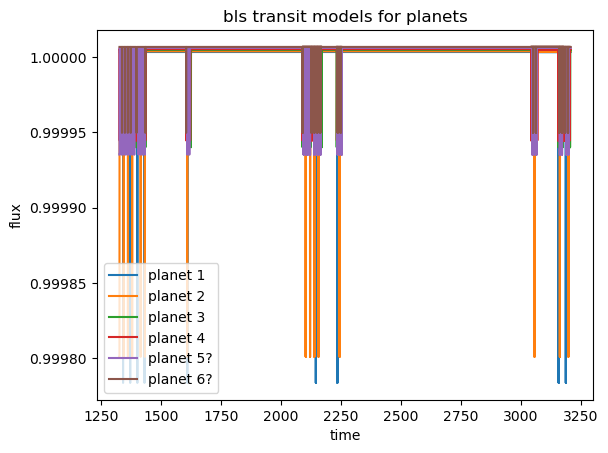

In [106]:
plt.plot(planet_1_model.time.value, planet_1_model.flux.value, label='planet 1')
plt.plot(planet_2_model.time.value, planet_2_model.flux.value, label='planet 2')
plt.plot(planet_3_model.time.value, planet_3_model.flux.value, label='planet 3')
plt.plot(planet_4_model.time.value, planet_4_model.flux.value, label='planet 4')
plt.plot(planet_5_model.time.value, planet_5_model.flux.value, label='planet 5?')
plt.plot(planet_6_model.time.value, planet_6_model.flux.value, label='planet 6?')

# plt.xlim(1335,1345)
# plt.xlim(1330,1350)
# plt.xlim(2100,2200)
# plt.xlim(1377,1380)
plt.title('bls transit models for planets')
plt.xlabel('time')
plt.ylabel('flux')
plt.legend()
plt.show()

# Fit Transit Times

In [44]:
from scipy.optimize import minimize
from scipy.optimize import root_scalar
from scipy.optimize import least_squares
from scipy.optimize import curve_fit

## Definitions

In [45]:
def omc(obs_time, t_num, p, tc):
    calc_time = tc + (t_num* p)
    omc = obs_time - calc_time
    return omc#*24 #days to hours

### Find the intersection points
def intersection_func(t,tc1,chi_sq, err_threshold): 
    return np.interp(t, tc1, chi_sq) - err_threshold

In [57]:

def plot_chi_sq(time, flux, flux_err, tc, tc_guess, per, rp, b, T14, u1, u2):
    '''
    args:
        time: array of times from lightcurve
        flux: array of fluxes from lightcurve
        flux_err: array of flux errors from lightcurve
        tc: range of values around the guess time
        tc_guess: guess transit time
        per: period of planet
        rp: radius ratio (planet/star)
        b: impact parameter
        T14: transit duration
        u1, u2: limb darkening coefficients 
    '''
    ### plot X^2 vs tc for each guess
    for j in range(len(tc)):
        tc1 = tc[j]
        chi_sq = np.zeros(len(tc1))
        chi_sq_lc = np.zeros(len(tc1))
        for i in range(len(tc1)):
            t0_1 = 	tc1[i]
            theta_initial = [t0_1, per, rp, b, T14, u1, u2]
            
            ### initialize params
            params = batman.TransitParams()
            # params.t0, params.per, params.rp,params.b, params.T14, q1, q2 = theta_initial
            # params.u = [2*np.sqrt(q1)*q2, np.sqrt(q1)*(1-2*q2)]  # Limb darkening coefficients
            params.t0, params.per, params.rp,params.b, params.T14, u1, u2 = theta_initial
            params.u = [u1, u2] 
            params.limb_dark = 'quadratic'
            
            ### mask data - extract relevant photometry
            start = tc_guess[j] - ttv_hour
            end = tc_guess[j] + ttv_hour
            mask = (time > (start)) & (time < (end))
            
            transit_model = batman.TransitModel(params, time[mask])
                
            # Generate model light curve
            model_flux = transit_model.light_curve(params)
            
            # Calculate chi-squared value
            sigma2 = flux_err[mask] 
            chi_squared = np.sum(((flux[mask] - model_flux) / sigma2)**2)
            chi_sq[i] = (chi_squared)
    
        ### masked
        min_chi_time = tc1[np.argmin(chi_sq)]
        min_chi = chi_sq.min()
    
        tc_chi[j] = min_chi_time
        # idx = transit_num[j]
        ttv[j] = min_chi_time - tc_guess[j]
    
        chi_mask = (chi_sq <= min_chi + 3)
        fit_mask = (chi_sq <= min_chi + 1)
    
        ### fit parabola to the chisq
        p_chi_sq = np.polyfit(tc1[fit_mask], chi_sq[fit_mask], 2)  
    
        ### Extract the coefficients   y = ax^2 + bx + c
        a_chi_sq, b_chi_sq, c_chi_sq = p_chi_sq
        
        ### Find the minimum of the parabola xmin = -b/2a from taking derivative=0
        tc_best_fit = -b_chi_sq / (2 * a_chi_sq)
        
        ### Calculate the minimum chi-squared value
        chi_sq_min = a_chi_sq * tc_best_fit**2 + b_chi_sq * tc_best_fit + c_chi_sq
        tc_chi_parabola[j] = tc_best_fit
    
        ### Calculate the parabola best fit 
        p_1 = a_chi_sq*tc1**2 + b_chi_sq*tc1 + c_chi_sq
    
        ### calculate ttv from parabola fit 
        ttv_p[j] = tc_best_fit - tc_guess[j]
    
        ### delta chisq = 1 gives errors
        err_threshold = min_chi + 1 # using chisq discrete minimum
        err_threshold_p = chi_sq_min + 1 # using minimum of parabola
      
        # # Find the intersection using root_scalar
        # intersections = []
        # for k in range(len(tc1) - 1):
        #     if (chi_sq[k] - err_threshold) * (chi_sq[k + 1] - err_threshold) < 0:
        #         sol = root_scalar(intersection_func, bracket=[tc1[k], tc1[k + 1]], args=(tc1, chi_sq, err_threshold))
        #         if sol.converged:
        #             intersections.append((sol.root - min_chi_time))
        # errors.append(intersections)
    
        # intersections_p = []
        # for k in range(len(tc1) - 1):
        #     if (p_1[k] - err_threshold_p) * (p_1[k + 1] - err_threshold_p) < 0:
        #         sol = root_scalar(intersection_func, bracket=[tc1[k], tc1[k + 1]], args=(tc1, chi_sq, err_threshold))
        #         if sol.converged:
        #             intersections_p.append((sol.root - tc_best_fit))
        # errors_p.append(intersections_p)
    
        # plt.plot(tc1[chi_mask], chi_sq[chi_mask],label='chisq')
        # plt.plot(tc1[chi_mask], p_1[chi_mask],label='chisq parabola', color='orange')
        # plt.axvline(x=tc_guess[j], color='r', linestyle='--', label='Bls Guess')
        # plt.axvline(x=min_chi_time, linestyle='--', label='Chisq min')
        # plt.axvline(x=tc1[np.argmin(p_1)], color='orange', linestyle='--', label='Chisq min parabola')
    
        # # for inter in intersections:
        # #     plt.axvline(x=inter, color='blue', linestyle='--')
        # plt.axhline(y=err_threshold, color='green', linestyle='--', label='Error Threshold')
        # plt.title(f'Transit {j+1}: Planet b')
        # plt.xlabel('tc')
        # plt.ylabel('X^2')
        # plt.legend()
        # plt.show()

In [47]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.ticker import FuncFormatter
import batman

def plot_transits(transit_times, per, rp, b, T14, u1, u2):
    cols = 3
    rows = int(np.ceil(len(transit_times) / cols))
    
    fig = plt.figure(figsize=(14, rows * 2.8))
    outer = gridspec.GridSpec(rows, cols, figure=fig, wspace=0.3, hspace=0.5)
    
    for i, t0 in enumerate(transit_times):
        row = i // cols
        col = i % cols
        inner = gridspec.GridSpecFromSubplotSpec(2, 1, subplot_spec=outer[row, col],
                                                 height_ratios=[3, 1], hspace=0.0)  # Panels touch
    
        t_min = t0 - buffer
        t_max = t0 + buffer
        mask = (time >= t_min) & (time <= t_max)
        time_rel = time[mask] - t0  # Time relative to Tc
    
        # Transit model setup
        theta_initial = [t0, per, rp, b, T14, u1, u2]
        params = batman.TransitParams()
        params.t0, params.per, params.rp, params.b, params.T14, u1, u2 = theta_initial
        params.u = [u1, u2]
        params.limb_dark = 'quadratic'
    
        m = batman.TransitModel(params, time[mask])
        model_flux = m.light_curve(params)
        residuals = flux[mask] - model_flux
    
        # Top panel: model + data
        ax1 = fig.add_subplot(inner[0])
        ax1.scatter(time_rel, flux[mask], s=5, label='Data')
        ax1.plot(time_rel, model_flux, color='red', label='Model')
        ax1.axvline(0, color='green', linestyle='--', label='Tc')
        ax1.set_xlim(-buffer, buffer)
        ax1.set_title(f'Tc = {round(t0, 3)} (BJD-{TESS_offset})')
        ax1.grid(True)
        ax1.tick_params(labelbottom=False)
    
        # Bottom panel: residuals
        ax2 = fig.add_subplot(inner[1], sharex=ax1)
        ax2.scatter(time_rel, residuals, s=5)
        ax2.axhline(0, color='red', linestyle='--', linewidth=1)
        ax2.set_xlim(-buffer, buffer)
        ax2.set_xlabel("Time from Tc [days]")
        ax2.grid(True)
    
        # Y-axis labels for first column only
        if col == 0:
            ax1.set_ylabel("Flux")
            ax2.set_ylabel("Residuals")
        else:
            ax1.set_ylabel("")
            ax1.tick_params(labelleft=False)
            ax2.set_ylabel("")
            ax2.tick_params(labelleft=False)
    
        # Custom ticks
        ticks = np.round(np.linspace(-buffer, buffer, 4), 2)
        ax2.set_xticks(ticks)
    
    plt.show()


In [70]:
### stellar params
u1 = 0.156 # p/m 0.041
u2 = 1.593 # p/m 0.040

## Planet 1

In [71]:
### Planet params (from exoplanet archive Demangeon et al 2021)
# planet b
per_1= 3.6906777
rp_1= 0.04088
b_1= 0.601
T14_1= 1.346 * 0.0416667  # convert to days from hours


In [72]:
tc_guess_1 = transit_times_1
### get tc ranges for fit
tc_1 = []
for i in range(len(tc_guess_1)):
    start = tc_guess_1[i] - ttv_hour
    end = tc_guess_1[i] + ttv_hour
    t = np.linspace(start,end, 1000)
    tc_1.append(t)

In [73]:
### initialize arrays
tc_chi = np.zeros(len(tc_1))
tc_chi_parabola = np.zeros(len(tc_1))
ttv = np.zeros(len(tc_1))
ttv_p = np.zeros(len(tc_1))
errors = []
errors_p = []

In [74]:
plot_chi_sq(time, flux, flux_err, tc_1, tc_guess_1, per_1, rp_1, b_1, T14_1, u1, u2)

/var/folders/69/wlx91x8s1x34mphlfjy0h4pm0000gn/T/ipykernel_21710/2805205177.py:59: RankWarning: Polyfit may be poorly conditioned
  p_chi_sq = np.polyfit(tc1[fit_mask], chi_sq[fit_mask], 2)
/var/folders/69/wlx91x8s1x34mphlfjy0h4pm0000gn/T/ipykernel_21710/2805205177.py:59: RankWarning: Polyfit may be poorly conditioned
  p_chi_sq = np.polyfit(tc1[fit_mask], chi_sq[fit_mask], 2)
/var/folders/69/wlx91x8s1x34mphlfjy0h4pm0000gn/T/ipykernel_21710/2805205177.py:59: RankWarning: Polyfit may be poorly conditioned
  p_chi_sq = np.polyfit(tc1[fit_mask], chi_sq[fit_mask], 2)
/var/folders/69/wlx91x8s1x34mphlfjy0h4pm0000gn/T/ipykernel_21710/2805205177.py:59: RankWarning: Polyfit may be poorly conditioned
  p_chi_sq = np.polyfit(tc1[fit_mask], chi_sq[fit_mask], 2)
/var/folders/69/wlx91x8s1x34mphlfjy0h4pm0000gn/T/ipykernel_21710/2805205177.py:59: RankWarning: Polyfit may be poorly conditioned
  p_chi_sq = np.polyfit(tc1[fit_mask], chi_sq[fit_mask], 2)
/var/folders/69/wlx91x8s1x34mphlfjy0h4pm0000gn/T/i

In [75]:
print(tc_chi)

[1356.20405131 1359.89287893 1363.58543559 1370.96247819 1374.657665
 1378.34373099 1441.0870868  1444.77830597 1448.46997151 1452.15801339
 1455.85197234 1459.54120458 1463.23204785 1518.59023396 1522.28048169
 1525.97200463 1537.04343089 1540.7354392  1544.42510007 1548.11577178
 1551.80582345 1555.56904738 1559.18862836 1562.87933567 1566.56831106
 1573.94940654 1577.64142706 1581.33137966 1585.02215806 1588.71377658
 1592.40444017 1603.47522589 1607.16570104 1618.23931811 1621.92838481
 1629.31428686 1633.00295663 1636.69289486 1644.07381572 1647.76508279
 1651.45545461 2064.81164686 2068.5018372  2072.19126667 2075.8879082
 2079.57387153 2083.26540432 2090.64856131 2094.33737208 2098.0306982
 2105.41014117 2109.10127597 2112.78876848 2175.53359343 2179.2205137
 2182.91511994 2190.29549096 2193.98603149 2197.67654509 2064.81156867
 2068.50176947 2075.88789465 2079.57393308 2083.26536368 2090.64851021
 2094.33739608 2098.03062    2105.41012762 2109.10119777 2175.53355275
 2179.22043

In [76]:
# Transit windows
buffer = 1.5 * T14_1
transit_times_1 = tc_chi

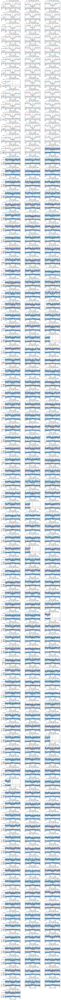

In [77]:
plot_transits(transit_times_1, per_1, rp_1, b_1, T14_1, u1, u2)

## Planet 2

In [78]:
### Planet params (from barros et al 2022)
# planet b
per_2= 2.2531136
rp_2= 0.02512
b_2= 0.53
T14_2= 0.9920 * 0.0416667  # convert to days from hours


In [79]:
tc_guess_2 = transit_times_2
### get tc ranges for fit
tc_2 = []
for i in range(len(tc_guess_2)):
    start = tc_guess_2[i] - 6*ttv_hour
    end = tc_guess_2[i] + 6*ttv_hour
    t = np.linspace(start,end, 1000)
    tc_2.append(t)

In [80]:
### initialize arrays
tc_chi = np.zeros(len(tc_2))
tc_chi_parabola = np.zeros(len(tc_2))
ttv = np.zeros(len(tc_2))
ttv_p = np.zeros(len(tc_2))
errors = []
errors_p = []

In [81]:
plot_chi_sq(time, flux, flux_err, tc_2, tc_guess_2, per_2, rp_2, b_2, T14_2, u1, u2)

/var/folders/69/wlx91x8s1x34mphlfjy0h4pm0000gn/T/ipykernel_21710/2805205177.py:59: RankWarning: Polyfit may be poorly conditioned
  p_chi_sq = np.polyfit(tc1[fit_mask], chi_sq[fit_mask], 2)
/var/folders/69/wlx91x8s1x34mphlfjy0h4pm0000gn/T/ipykernel_21710/2805205177.py:59: RankWarning: Polyfit may be poorly conditioned
  p_chi_sq = np.polyfit(tc1[fit_mask], chi_sq[fit_mask], 2)
/var/folders/69/wlx91x8s1x34mphlfjy0h4pm0000gn/T/ipykernel_21710/2805205177.py:59: RankWarning: Polyfit may be poorly conditioned
  p_chi_sq = np.polyfit(tc1[fit_mask], chi_sq[fit_mask], 2)
/var/folders/69/wlx91x8s1x34mphlfjy0h4pm0000gn/T/ipykernel_21710/2805205177.py:59: RankWarning: Polyfit may be poorly conditioned
  p_chi_sq = np.polyfit(tc1[fit_mask], chi_sq[fit_mask], 2)
/var/folders/69/wlx91x8s1x34mphlfjy0h4pm0000gn/T/ipykernel_21710/2805205177.py:59: RankWarning: Polyfit may be poorly conditioned
  p_chi_sq = np.polyfit(tc1[fit_mask], chi_sq[fit_mask], 2)
/var/folders/69/wlx91x8s1x34mphlfjy0h4pm0000gn/T/i

In [82]:
print(tc_chi)

[1354.90579527 1357.15492048 1359.50075677 1361.55908053 1363.91854263
 1366.15965883 1370.68038295 1372.93190843 1375.18766422 1377.43741413
 1379.68816381 1438.27111001 1440.51891083 1442.7737223  1445.03592973
 1447.28273423 1449.53654373 1451.78673215 1454.02814907 1456.28636068
 1458.55219306 1460.80301017 1463.05382509 1519.38981804 1521.63463826
 1523.89647376 1526.0331815  1528.40550846 1535.23703918 1537.40477371
 1539.66582344 1541.91078924 1546.41941496 1548.66060431 1550.92442595
 1553.17923482 1555.49209494 1557.77392422 1559.94003043 1562.19083163
 1564.44663469 1566.7915227  1571.20038767 1573.45918798 1575.7089768
 1577.96215325 1580.21593849 1586.98167159 1589.22344068 1591.4842256
 1593.71597731 1602.74545388 1605.09069957 1607.17629425 1609.51213366
 1616.26778697 1618.52454627 1620.77968833 1623.02442809 1629.78606066
 1632.03719266 1634.19445321 1636.44919546 1638.79880135 1643.29949628
 1645.56001782 1647.76280448 1650.06248608 1652.31421557 2062.47710788
 2064.53

In [83]:
# Transit windows
buffer = 1.5 * T14_2
transit_times_2 = tc_chi

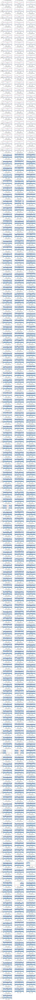

In [84]:
plot_transits(transit_times_2, per_2, rp_2, b_2, T14_2, u1, u2)

## Planet 3

In [93]:
### Planet params (from barros et al 2022)
# planet e
per_3= 7.90754
rp_3= 0.01065
b_3= 0.50
T14_3= 2.48 * 0.0416667  # convert to days from hours


In [94]:
tc_guess_3 = transit_times_3
### get tc ranges for fit
tc_3 = []
for i in range(len(tc_guess_3)):
    start = tc_guess_3[i] - 6*ttv_hour
    end = tc_guess_3[i] + 6*ttv_hour
    t = np.linspace(start,end, 1000)
    tc_3.append(t)

In [95]:
### initialize arrays
tc_chi = np.zeros(len(tc_3))
tc_chi_parabola = np.zeros(len(tc_3))
ttv = np.zeros(len(tc_3))
ttv_p = np.zeros(len(tc_3))
errors = []
errors_p = []

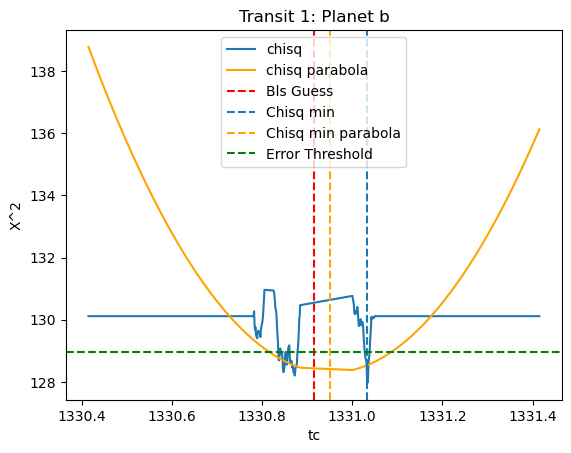

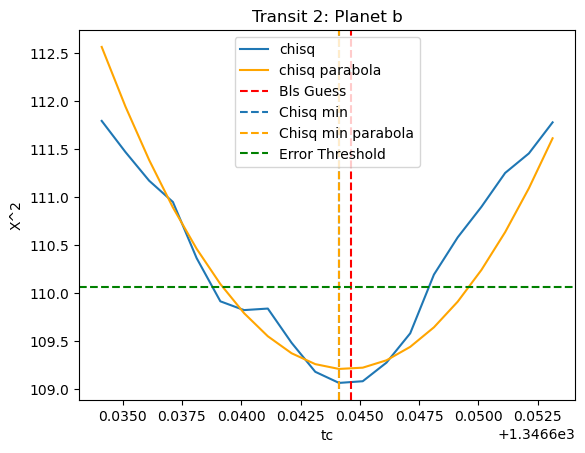

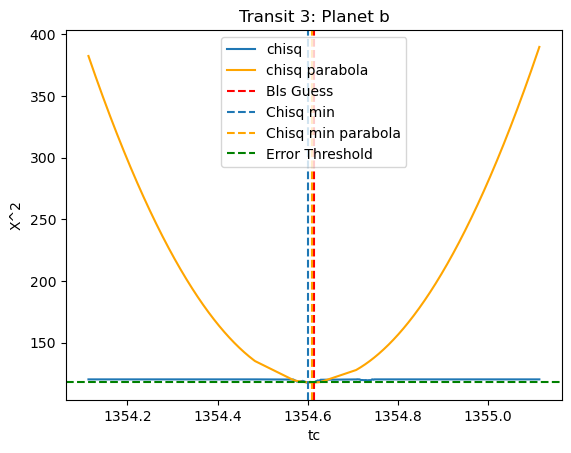

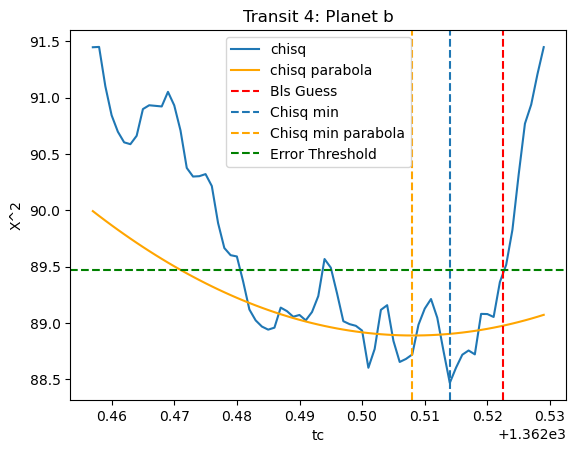

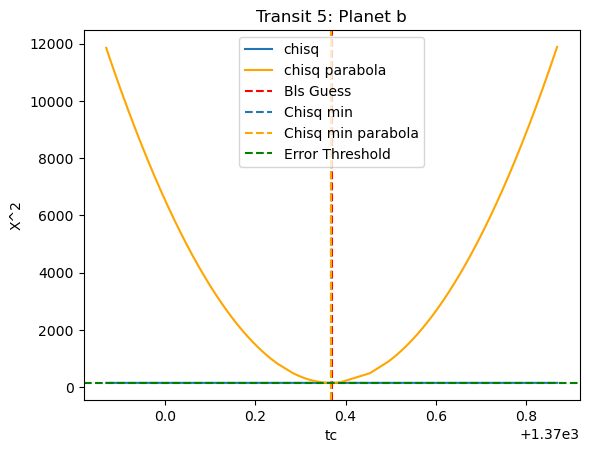

...

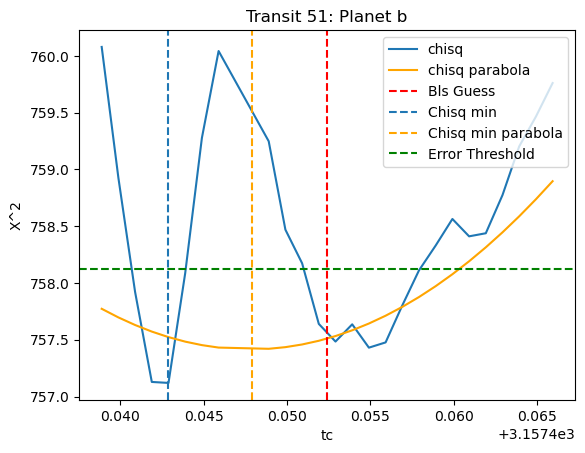

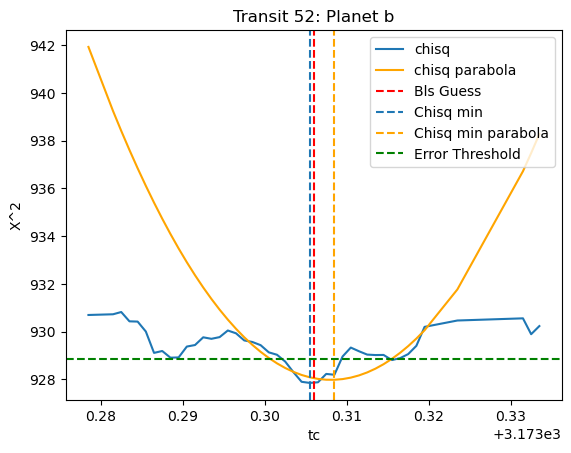

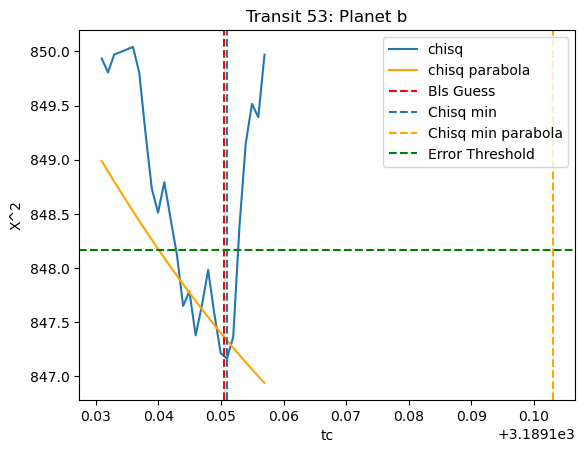

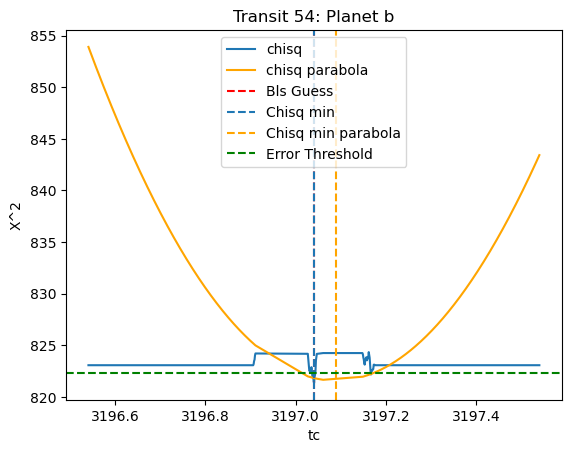

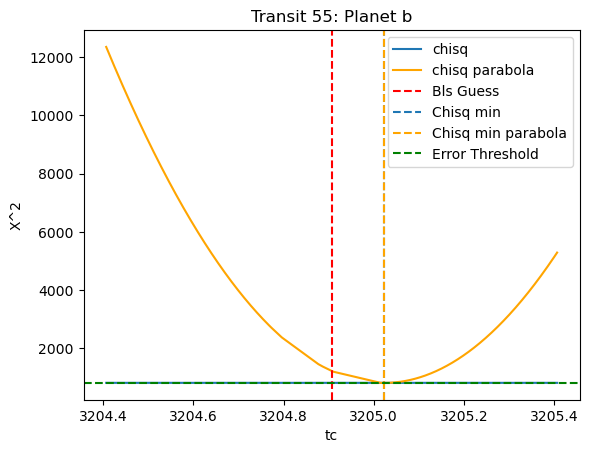

In [96]:
plot_chi_sq(time, flux, flux_err, tc_3, tc_guess_3, per_3, rp_3, b_3, T14_3, u1, u2)

In [97]:
# Transit windows
buffer = 1.5 * T14_3
transit_times_3 = tc_chi
print(transit_times_3)

[1331.03378699 1346.64412374 1354.60020641 1362.51401424 1370.36856521
 1378.3265128  1386.19487561 1394.03972646 1402.01345625 1417.62495474
 1425.71694708 1433.62829698 1607.58947397 1623.41807183 2121.56579445
 2137.15626061 2145.08197807 2153.23712092 2161.13152804 2169.05301147
 2089.73719271 2097.87865965 2105.77509426 2121.56606035 2137.15598848
 2145.27143332 2153.23669861 2161.1314874  2169.05266425 2089.736614
 2097.87885046 2105.77482211 2232.04472142 2240.46207304 2247.91117528
 2232.04429911 2240.20870384 2247.91129102 3189.15030734 3197.03797255
 3205.0217062  3046.80600362 3054.43797782 3062.38854967 3157.44247181
 3165.14226661 3173.30629289 3046.7584529  3054.43863159 3062.38874048
 3157.44289409 3173.30548269 3189.15096111 3197.04093488 3205.02235998]


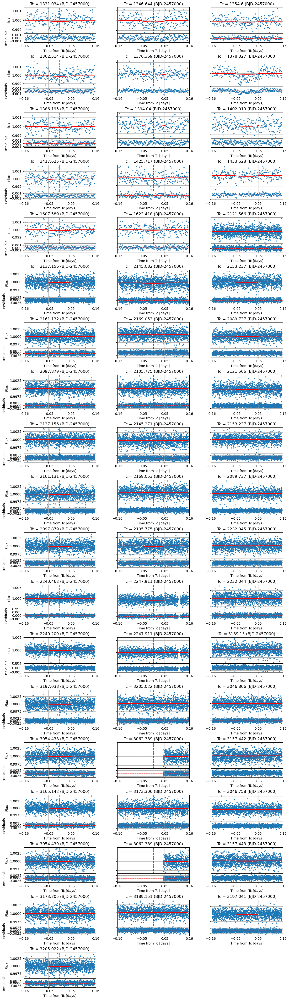

In [98]:
plot_transits(transit_times_3, per_3, rp_3, b_3, T14_3, u1, u2)

## Planet 4

In [99]:
### Planet params (from barros et al 2022)
# planet d
per_4= 3.97664
rp_4= 0.009752
b_4= 0.47
T14_4= 1.99 * 0.0416667  # convert to days from hours


In [100]:
tc_guess_4 = transit_times_4
### get tc ranges for fit
tc_4 = []
for i in range(len(tc_guess_4)):
    start = tc_guess_4[i] - ttv_hour
    end = tc_guess_4[i] + ttv_hour
    t = np.linspace(start,end, 1000)
    tc_4.append(t)

In [101]:
### initialize arrays
tc_chi = np.zeros(len(tc_4))
tc_chi_parabola = np.zeros(len(tc_4))
ttv = np.zeros(len(tc_4))
ttv_p = np.zeros(len(tc_4))
errors = []
errors_p = []

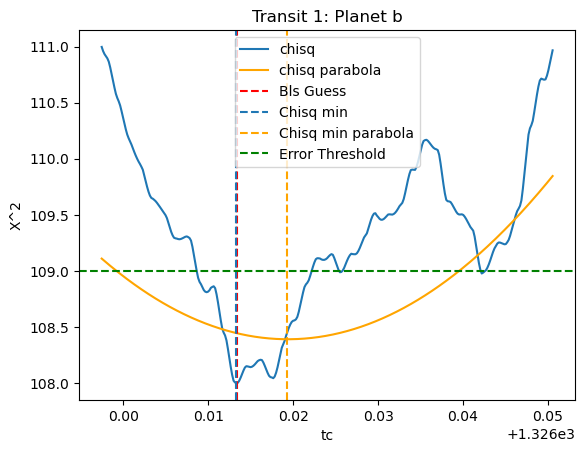

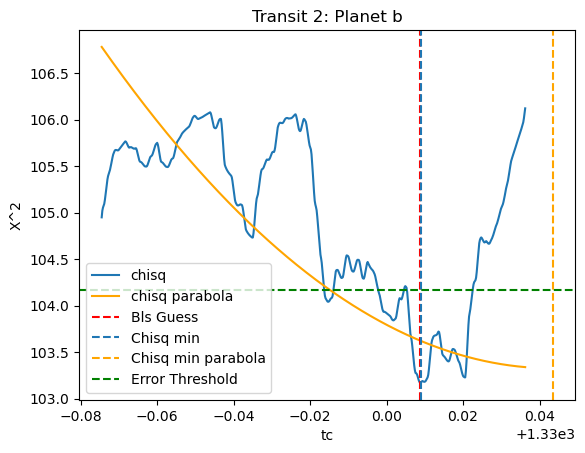

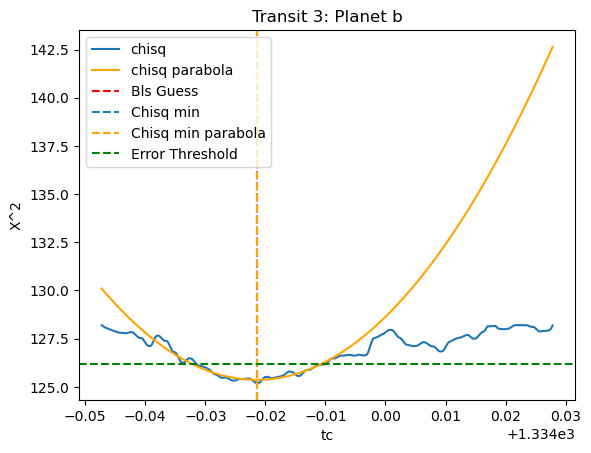

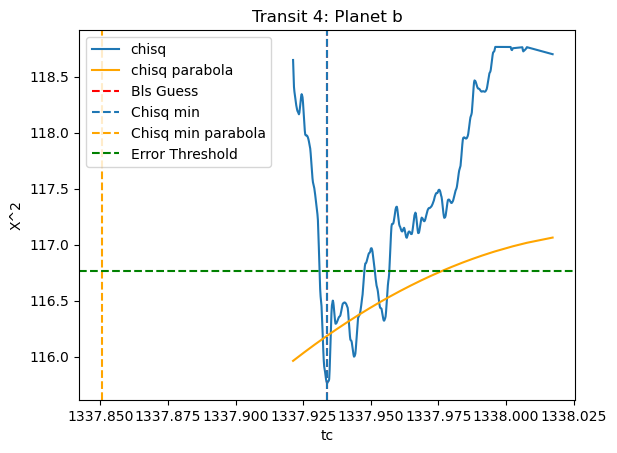

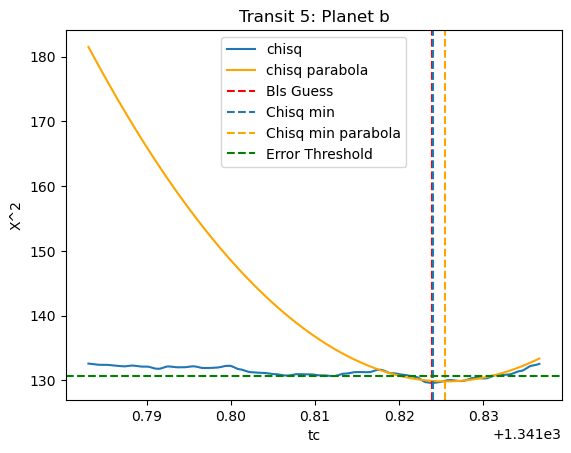

...

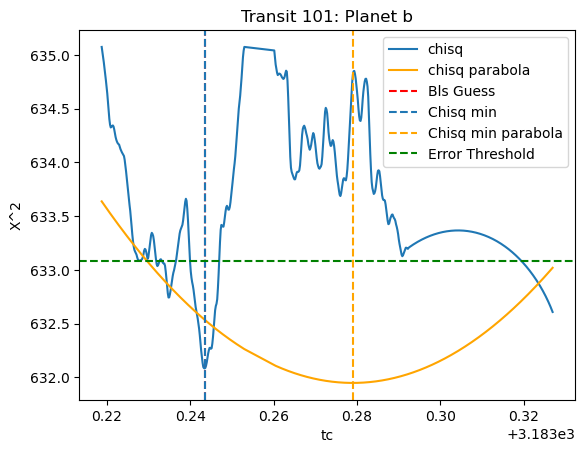

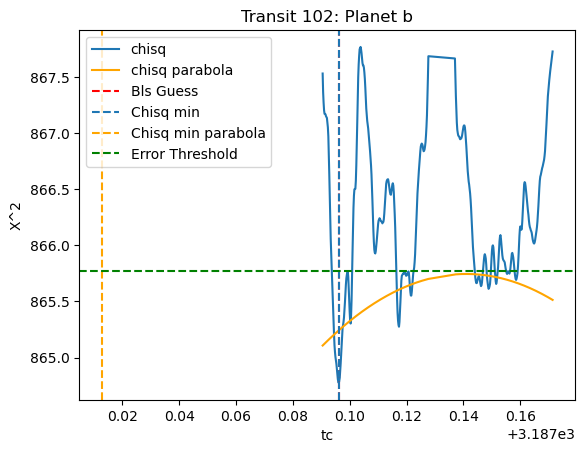

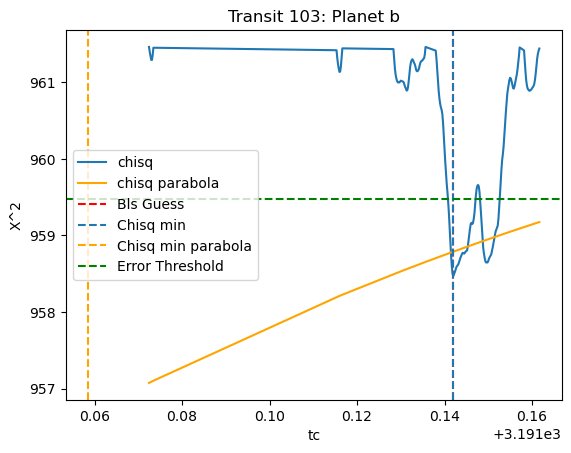

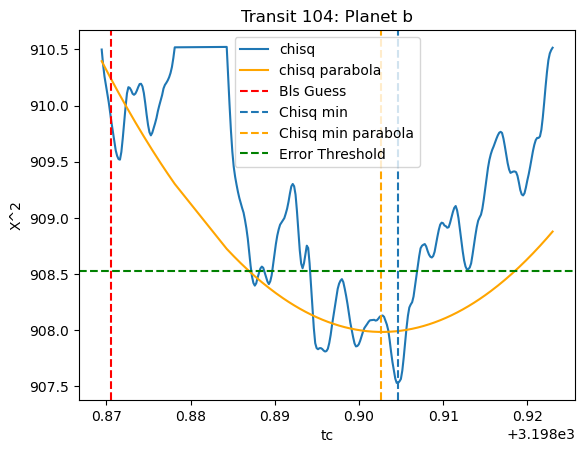

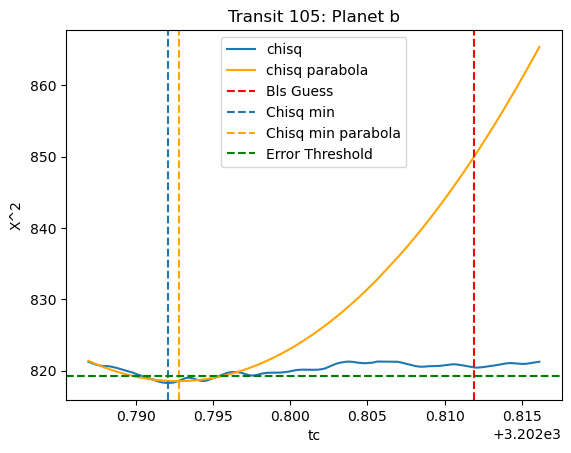

In [102]:
plot_chi_sq(time, flux, flux_err, tc_4, tc_guess_4, per_4, rp_4, b_4, T14_4, u1, u2)

In [103]:
# Transit windows
buffer = 1.5 * T14_4
transit_times_4 = tc_chi
print(transit_times_4)

[1326.01332495 1330.0088742  1333.97860735 1337.93392905 1341.82396268
 1345.93855301 1349.87779208 1357.75930345 1361.84283767 1365.90350484
 1369.76129585 1373.76973713 1377.70865274 1389.63485744 1393.63158003
 1397.60777355 1401.59764826 1405.56137433 1413.48886618 1417.453743
 1421.40498764 1425.41972987 1429.45377299 1433.39504831 1604.3918907
 1608.47211479 1616.41942571 1620.30346943 2117.37508    2121.26530553
 2125.17287003 2133.43727951 2137.41873358 2141.22122967 2145.32662848
 2149.20092294 2153.24672165 2165.08354955 2089.53253159 2093.56738517
 2097.55110116 2105.4744156  2109.27390159 2117.37510398 2121.26539416
 2125.17291069 2133.43727639 2137.41879512 2141.22117857 2145.25941851
 2149.20088229 2153.2467352  2165.08350891 2089.53255557 2093.56737161
 2097.55095831 2105.47441247 2109.49223573 2232.7308151  2236.64692087
 2240.65711221 2244.64610657 2248.65998127 2252.57396157 2232.73074736
 2236.64686977 2240.65703402 2244.64602838 2248.65987598 2252.57401267
 3183.243

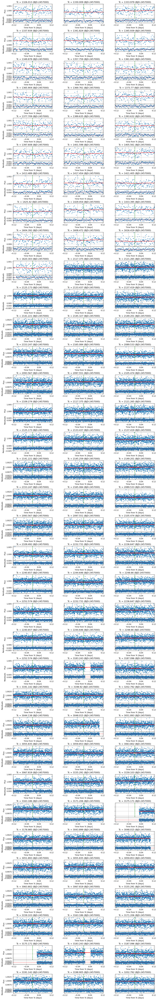

In [104]:
plot_transits(transit_times_4, per_4, rp_4, b_4, T14_4, u1, u2)